# Summarizing data with PCA
* This activity is meant to explore the results of applying PCA to a dataset. Below, a dataset from a credit card company is loaded and displayed. This dataset contains customer data pertaining to demographic and payment information as well as basic demographics. The final column default payment next month is what we want to create profiles for.

* You are to use PCA and reduce the dimensionality of the data to 2 and 3 dimensions. Then, draw scatterplots of the resulting data and color them by default. Does it seem that 2 or 3 principal components will seperate the data into clear groups? Why or why not? You should post your visualizations and argument for whether the components offer more succinct data representations on the discussion board for this activity. (Note: In this assignment you should use the sklearn version of PCA.)

In [105]:
import pandas as pd
from mpl_toolkits import mplot3d
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import numpy as np
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
import matplotlib as mpl
from cycler import cycler
sns.set_style("whitegrid")
sns.set_context("talk")
plt.style.use('ggplot')
mpl.rcParams['figure.figsize'] = (12,8)
import mglearn
import sklearn
from sklearn.preprocessing import scale


* URL_1: https://philippschmalen.github.io/posts/predicting-esg-risks-with-pytorch-google-trends-and-amazon-sagemaker/
* URL_2: https://towardsdatascience.com/understand-your-data-with-principle-component-analysis-pca-and-discover-underlying-patterns-d6cadb020939
* URL_3: https://www.reneshbedre.com/blog/principal-component-analysis.html
* URL_4: https://plotly.com/python/pca-visualization/

In [56]:

default = pd.read_csv('C:/Users/hande/Downloads/credit.csv', index_col=0)

default.dropna(how='all', inplace= True)
default.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
ID,,,,,,,,,,,,,,,,,,,,,
1,20000.0,2,2,1,24,2,2,-1,-1,-2,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
2,120000.0,2,2,2,26,-1,2,0,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
3,90000.0,2,2,2,34,0,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
4,50000.0,2,2,1,37,0,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
5,50000.0,1,2,1,57,-1,0,-1,0,0,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0


In [110]:
default.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30000 entries, 1 to 30000
Data columns (total 24 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   LIMIT_BAL                   30000 non-null  float64
 1   SEX                         30000 non-null  int64  
 2   EDUCATION                   30000 non-null  int64  
 3   MARRIAGE                    30000 non-null  int64  
 4   AGE                         30000 non-null  int64  
 5   PAY_0                       30000 non-null  int64  
 6   PAY_2                       30000 non-null  int64  
 7   PAY_3                       30000 non-null  int64  
 8   PAY_4                       30000 non-null  int64  
 9   PAY_5                       30000 non-null  int64  
 10  PAY_6                       30000 non-null  int64  
 11  BILL_AMT1                   30000 non-null  float64
 12  BILL_AMT2                   30000 non-null  float64
 13  BILL_AMT3                   300

# Preprocessing and feature engineering:

**Select features, impute missings and standardize:**

In [135]:
X= default.iloc[:, 0:24].values
y= default.AGE.values # Target variable

# select relevant features 
selected_features = ['SEX','EDUCATION ','MARRIAGE ','AGE',
                     'PAY_0','PAY_2','PAY_3','PAY_4 ','PAY_5','PAY_5',
                     'PAY_6','BILL_AMT1','BILL_AMT2','BILL_AMT3','BILL_AMT4',
                     'BILL_AMT5','BILL_AMT6','PAY_AMT1','PAY_AMT2','PAY_AMT3','PAY_AMT4','PAY_AMT5',
                     'PAY_AMT6','default payment next month']


X= StandardScaler().fit_transform(X)

# Main Part: PCA

**1) Initialize**

In [136]:
# initialize and compute pca

from sklearn.decomposition import PCA
#pca = PCA(n_components = 2) # keep the first two principal components of the data
pca = PCA()
X_pca = pca.fit_transform(X)

**2) Inspect properties: I. explained variance**

In [137]:
# get basic info
n_components = len(pca.explained_variance_ratio_)
explained_variance = pca.explained_variance_ratio_
cum_explained_variance = np.cumsum(explained_variance)
idx = np.arange(n_components)+1

df_explained_variance = pd.DataFrame([explained_variance, cum_explained_variance], 
                                     index=['explained variance', 'cumulative'], 
                                     columns=idx).T

mean_explained_variance = df_explained_variance.iloc[:,0].mean() # calculate mean explained variance

# DISPLAY info about PCs
print('PCA Overview')
print('='*40)
print("Total: {} components".format(n_components))
print('-'*40)
print('Mean explained variance:', round(mean_explained_variance,3))
print('-'*40)
print(df_explained_variance.head(20))
print('-'*40)

PCA Overview
Total: 24 components
----------------------------------------
Mean explained variance: 0.042
----------------------------------------
    explained variance  cumulative
1             0.272986    0.272986
2             0.175063    0.448049
3             0.064709    0.512758
4             0.061473    0.574230
5             0.043353    0.617583
6             0.040602    0.658185
7             0.038168    0.696353
8             0.037791    0.734144
9             0.036926    0.771070
10            0.036302    0.807372
11            0.032619    0.839991
12            0.030512    0.870503
13            0.026164    0.896667
14            0.023730    0.920397
15            0.021849    0.942246
16            0.016574    0.958820
17            0.010818    0.969638
18            0.010367    0.980005
19            0.007861    0.987866
20            0.005491    0.993357
----------------------------------------


**3) Visualize explained variance: Scree plot**

Limit scree plot to nth component (0 for all) >  24


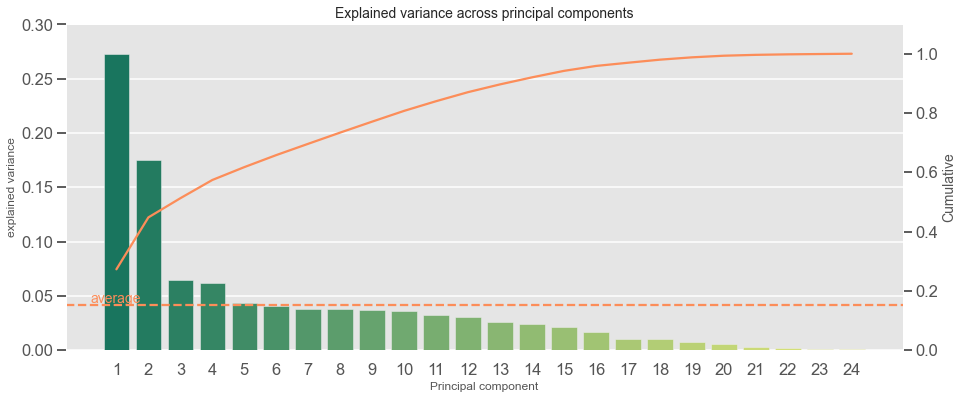

In [179]:
#limit plot to x PC
limit = int(input("Limit scree plot to nth component (0 for all) > "))
if limit > 0:
    limit_df = limit
else:
    limit_df = n_components

df_explained_variance_limited = df_explained_variance.iloc[:limit_df,:]

#make scree plot
fig, ax1 = plt.subplots(figsize=(15,6))

ax1.set_title('Explained variance across principal components', fontsize=14)
ax1.set_xlabel('Principal component', fontsize=12)
ax1.set_ylabel('Explained variance', fontsize=12)

ax2 = sns.barplot(x=idx[:limit_df], y='explained variance', data=df_explained_variance_limited, palette='summer')
ax2 = ax1.twinx()
ax2.grid(False)

ax2.set_ylabel('Cumulative', fontsize=14)
ax2 = sns.lineplot(x=idx[:limit_df]-1, y='cumulative', data=df_explained_variance_limited, color='#fc8d59')

ax1.axhline(mean_explained_variance, ls='--', color='#fc8d59') #plot mean
ax1.text(-.8, mean_explained_variance+(mean_explained_variance*.05), "average", color='#fc8d59', fontsize=14) #label y axis

max_y1 = max(df_explained_variance_limited.iloc[:,0])
max_y2 = max(df_explained_variance_limited.iloc[:,1])
ax1.set(ylim=(0, max_y1+max_y1*.1))
ax2.set(ylim=(0, max_y2+max_y2*.1))

plt.show()

**4)Inspect properties: II. Correlations of features and components (factor loadings)**

In [100]:
# Extra Info:

from sklearnex import patch_sklearn
patch_sklearn()

from sklearn.decomposition import PCA
p = PCA()
p.get_params()

from sklearnex import unpatch_sklearn
unpatch_sklearn()
from sklearn.decomposition import PCA
p = PCA()
p.get_params()

Intel(R) Extension for Scikit-learn* enabled (https://github.com/intel/scikit-learn-intelex)


{'copy': True,
 'iterated_power': 'auto',
 'n_components': None,
 'random_state': None,
 'svd_solver': 'auto',
 'tol': 0.0,
 'whiten': False}

In [139]:
############### DEFINE PARAMS
top_k = 3
#select data based on percentile (top_q) or top-k features
top_q = .50
top_pc = 3
###############

# PCA factor loadings
df_c = pd.DataFrame(pca_out.components_, columns=selected_features).T

print("Factor Loadings for the 1. component \n(explains {0:.2f} of the variance)".format(df_explained_variance.iloc[0,0]))
print('='*40,'\n')
print('Top {} highest'.format(top_k))
print('-'*40)
print(df_c.iloc[:,0].sort_values(ascending=False)[:top_k], '\n')

print('Top {} lowest'.format(top_k))
print('-'*40)
print(df_c.iloc[:,0].sort_values()[:top_k])

Factor Loadings for the 1. component 
(explains 0.27 of the variance)

Top 3 highest
----------------------------------------
BILL_AMT4    0.352208
BILL_AMT5    0.350113
BILL_AMT3    0.348081
Name: 0, dtype: float64 

Top 3 lowest
----------------------------------------
EDUCATION    -0.022059
AGE          -0.005560
PAY_0         0.013975
Name: 0, dtype: float64


**5) Visualize factor loadings: Heatmap**

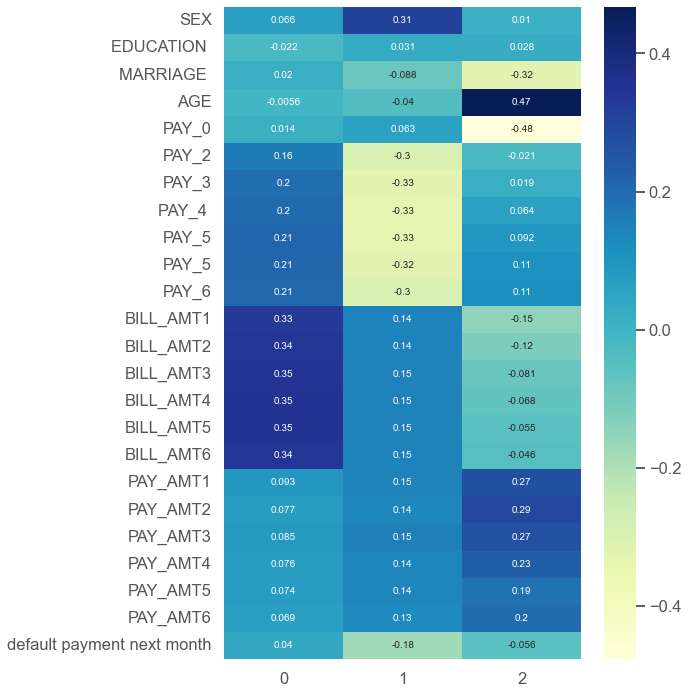

In [140]:
# Plot heatmap
size_yaxis = round(X.shape[1] * 0.5)

fig, ax = plt.subplots(figsize=(8,size_yaxis))
sns.heatmap(df_c.iloc[:,:top_pc], annot=True, cmap="YlGnBu", ax=ax)
plt.show()

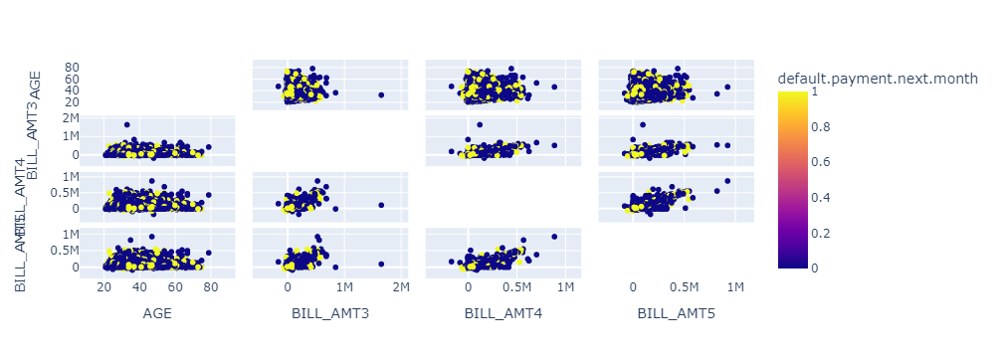

In [152]:
import plotly.express as px

df = default.copy()
features = ['AGE', 'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5']

fig = px.scatter_matrix(
    df,
    dimensions=features,
    color= 'default.payment.next.month'
)
fig.update_traces(diagonal_visible=False)
fig.show()

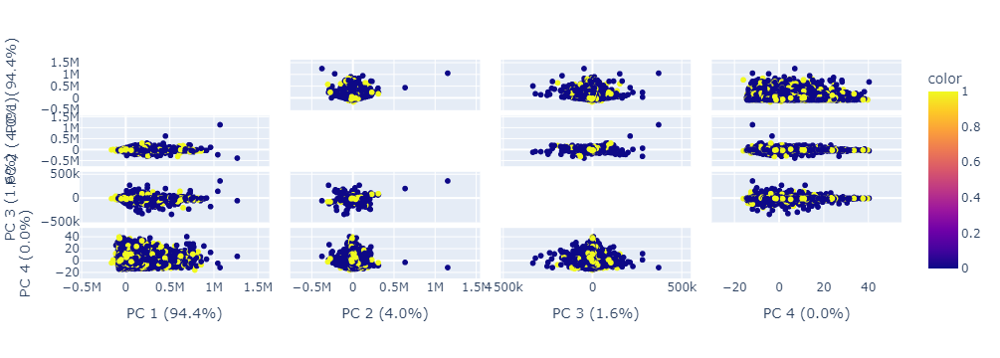

In [154]:
import plotly.express as px
from sklearn.decomposition import PCA

df = default.copy()
features = ['AGE', 'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5']

pca = PCA()
components = pca.fit_transform(df[features])
labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}

fig = px.scatter_matrix(
    components,
    labels=labels,
    dimensions=range(4),
    color=df['default.payment.next.month']
)
fig.update_traces(diagonal_visible=False)
fig.show()

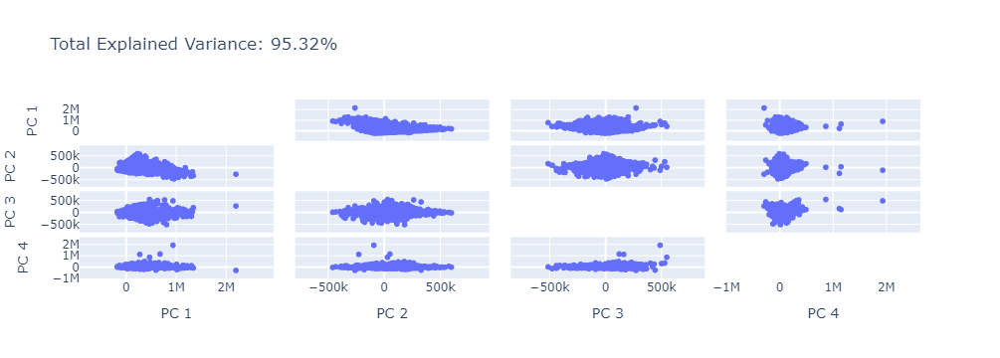

In [165]:
import pandas as pd
import plotly.express as px
from sklearn.decomposition import PCA


df = default.copy()
features = ['AGE', 'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5']
n_components = 4

pca = PCA(n_components=n_components)
components = pca.fit_transform(df)

total_var = pca.explained_variance_ratio_.sum() * 100

labels = {str(i): f"PC {i+1}" for i in range(n_components)}
labels['default.payment.next.month'] = 'default.payment.next.month'

fig = px.scatter_matrix(
    components,
    dimensions=range(n_components),
    labels=labels,
    title=f'Total Explained Variance: {total_var:.2f}%',
)
fig.update_traces(diagonal_visible=False)
fig.show()

In [180]:
import plotly.express as px
from sklearn.decomposition import PCA

df = default.copy()
X = df[['AGE', 'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5']]


pca = PCA(n_components=3)
components = pca.fit_transform(X)

total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_3d(
    components, x=0, y=1, z=2, color=df['default.payment.next.month'],
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show()

# Visualize Loadings

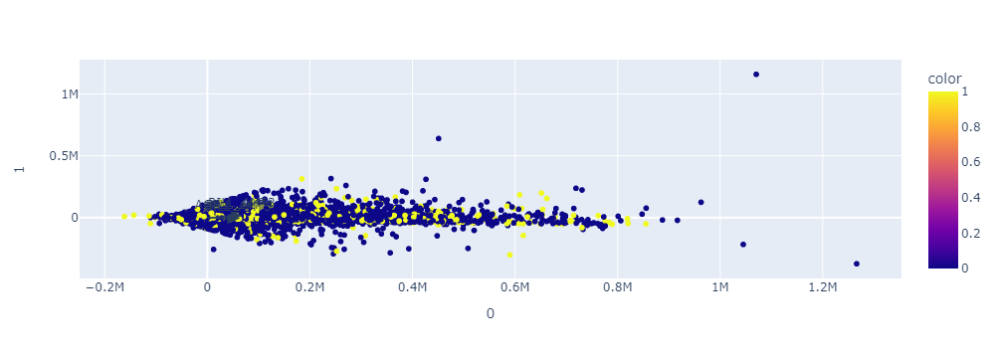

In [178]:
import plotly.express as px
from sklearn.decomposition import PCA
from sklearn import datasets
from sklearn.preprocessing import StandardScaler


features = ['AGE', 'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5']
X = df[features]

pca = PCA(n_components=4)
components = pca.fit_transform(X)

df_c = pd.DataFrame(pca_out.components_, columns=selected_features).T

fig = px.scatter(components, x=0, y=1, color=df['default.payment.next.month'])

for i, feature in enumerate(features):
    fig.add_annotation(
        ax=0, ay=0,
        axref="x", ayref="y",
        x=loadings[i, 0],
        y=loadings[i, 1],
        showarrow=True,
        arrowsize=2,
        arrowhead=2,
        xanchor="right",
        yanchor="top"
    )
    fig.add_annotation(
        x=loadings[i, 0],
        y=loadings[i, 1],
        ax=0, ay=0,
        xanchor="center",
        yanchor="bottom",
        text=feature,
        yshift=5,
    )
fig.show()